In [1]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df_acc = pd.read_csv(r'D:/VSCODE code/MTH 522 Code/Project 3/tmpny7ipd0n.csv')

In [3]:
df_acc.head()

,dispatch_ts,mode_type,location_type,street,xstreet1,xstreet2,x_cord,y_cord,lat,long
0,2015-01-01 00:24:27+00,mv,Intersection,NaN,TRAIN ST,WESTGLOW ST,777243.68,2930930.11,42.289749,-71.052516
1,2015-01-01 03:50:33+00,mv,Street,RIVER ST,WALTER ST,WINTHROP ST,758927.71,2918981.60,42.257078,-71.120106
2,2015-01-01 10:14:13+00,ped,Intersection,NaN,LONDON ST,MERIDIAN ST,780725.19,2961410.17,42.373337,-71.039040
3,2015-01-01 18:23:57+00,bike,Intersection,NaN,OLNEY ST,INWOOD ST,772710.48,2936614.62,42.305412,-71.069164
4,2015-01-01 18:42:19+00,ped,Intersection,NaN,WASHINGTON ST,COLUMBUS AVE,764813.61,2940364.63,42.315808,-71.098291


In [4]:
df_acc['dispatch_ts'] = pd.to_datetime(df_acc['dispatch_ts'],format = 'ISO8601', utc=True)
df_acc['Timestamp'] = pd.to_datetime(df_acc['dispatch_ts'],format = 'ISO8601')

cutoff_date = pd.to_datetime('2023-10-31', utc=True)
cutoff_date2 = pd.to_datetime('2015-07-01', utc=True)

df_acc = df_acc[df_acc['Timestamp']>= cutoff_date2].copy()
df_acc = df_acc[df_acc['Timestamp']<= cutoff_date].copy()

In [5]:
import folium

In [6]:
locations = df_acc[['lat', 'long']].copy()

locations.head()

,lat,long
1831,42.350070,-71.146348
1832,42.358769,-71.072311
1833,42.337746,-71.095742
1834,42.362513,-71.061616
1835,42.329733,-71.037244


In [7]:
# Create a map centered at the coordinates of the United States
boston_map_accidents = folium.Map(location=[42.3601, -71.0589], zoom_start=8)

# Define your latitude and longitude data 
for index, row in locations.iterrows():
    #tier_color = color_dict.get(row['Tier'], 'gray')
    marker = folium.CircleMarker(
        location = [row['lat'], row['long']],
        radius = 0.01,
        #popup=row['Tier'],
        color = 'red',
        fill = True,
        fill_color = 'red',
        fill_opacity = 0.6
    )
    marker.add_to(boston_map_accidents)

# Save the map to an HTML file
boston_map_accidents.save("boston_map_accidents.html")
boston_map_accidents

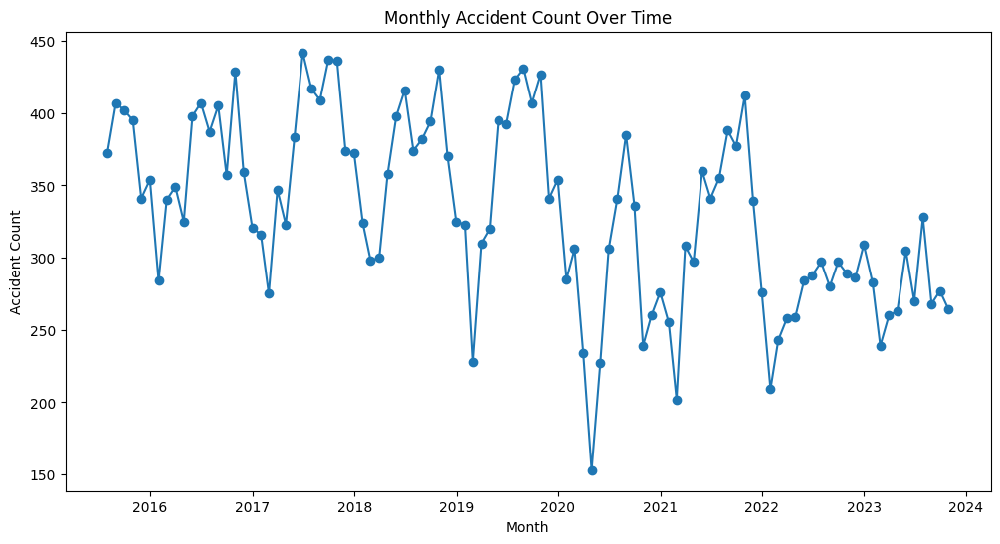

In [8]:
# Assuming your DataFrame is named 'crime_df'
df_acc['Timestamp'] = pd.to_datetime(df_acc['Timestamp'], utc = True)
monthly_accident_count = df_acc.resample('M', on='Timestamp').size()

plt.figure(figsize=(12, 6))
plt.plot(monthly_accident_count, marker='o')
plt.title('Monthly Accident Count Over Time')
plt.xlabel('Month')
plt.ylabel('Accident Count')
plt.show()

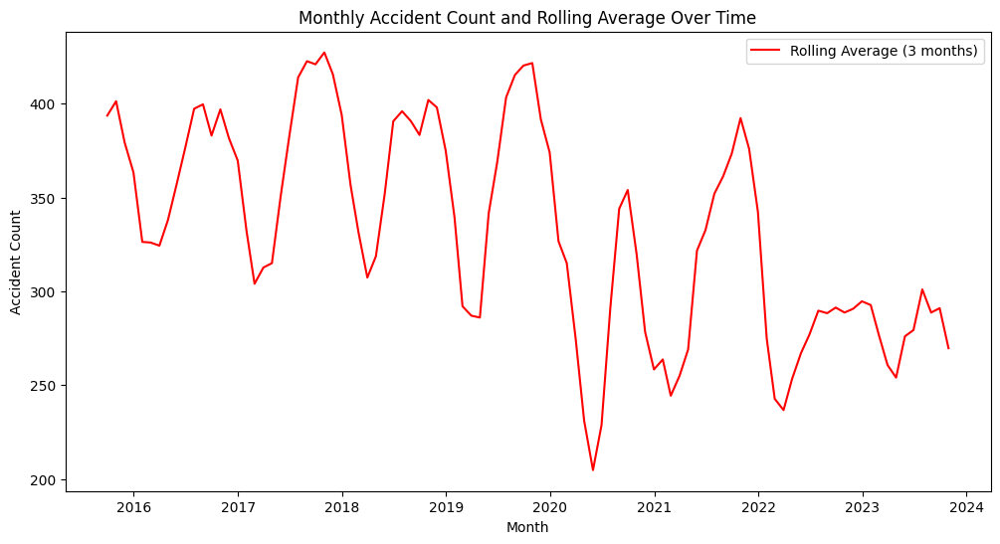

In [9]:
#Rolling average over a 3 month period

rolling_avg = monthly_accident_count.rolling(window=3).mean()

# Plot the monthly accident count and the rolling average
plt.figure(figsize=(12, 6))
#plt.plot(monthly_accident_count, marker='o', label='Monthly Count')
plt.plot(rolling_avg, color='red', label='Rolling Average (3 months)')
plt.title('Monthly Accident Count and Rolling Average Over Time')
plt.xlabel('Month')
plt.ylabel('Accident Count')
plt.legend()
plt.show()

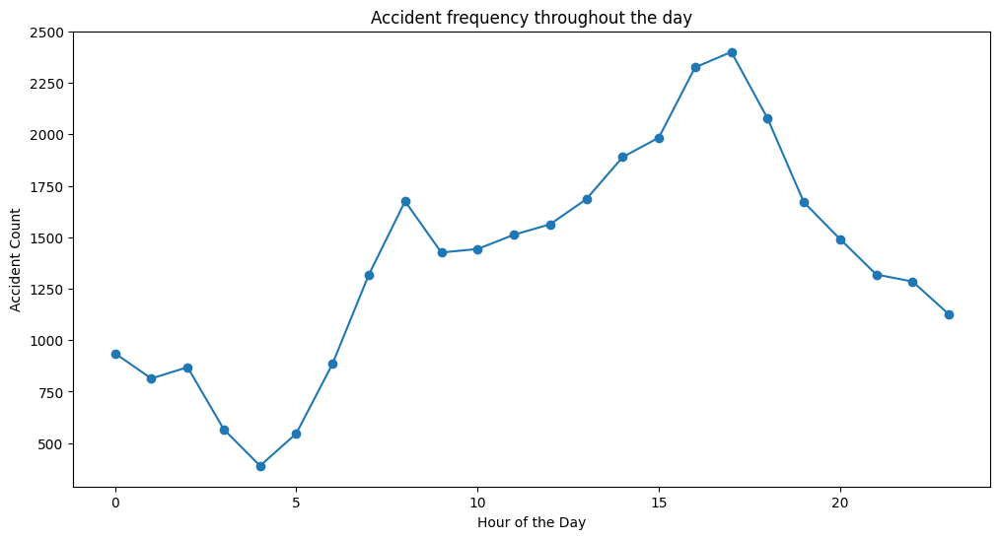

In [13]:

df_acc['Hour'] = df_acc['Timestamp'].dt.hour
hourly_accident_count = df_acc.groupby('Hour').size()

plt.figure(figsize=(12, 6))
plt.plot(hourly_accident_count, marker='o')
plt.title('Accident frequency throughout the day')
plt.xlabel('Hour of the Day')
plt.ylabel('Accident Count')
plt.show()

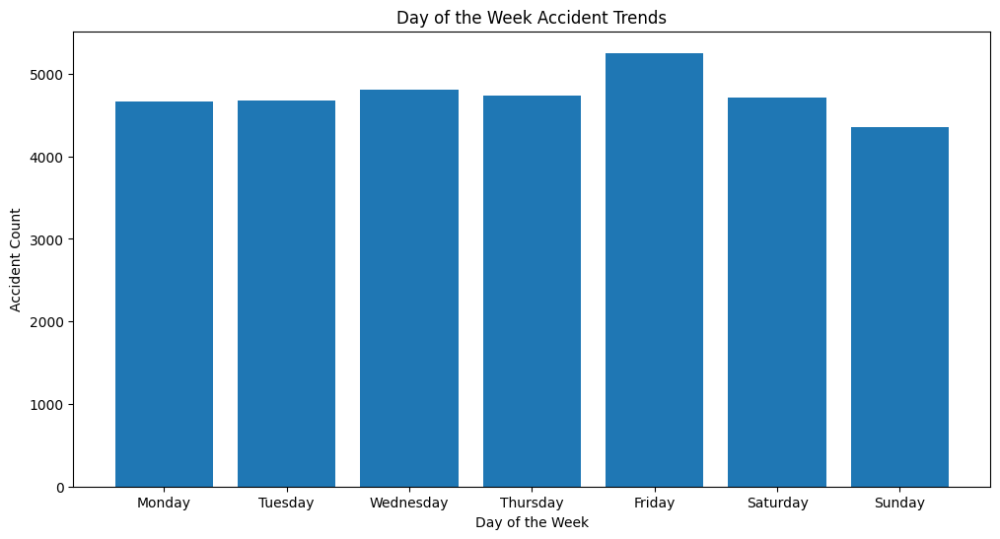

In [14]:
df_acc['Day_of_Week'] = df_acc['Timestamp'].dt.day_name()
day_of_week_accident_count = df_acc.groupby('Day_of_Week').size()

# Reorder days of the week for better visualization
ordered_days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
day_of_week_accident_count = day_of_week_accident_count.reindex(ordered_days)

plt.figure(figsize=(12, 6))
plt.bar(day_of_week_accident_count.index, day_of_week_accident_count)
plt.title('Day of the Week Accident Trends')
plt.xlabel('Day of the Week')
plt.ylabel('Accident Count')
plt.show()

---

In [16]:
train_size = int(len(monthly_accident_count) * 0.8)
train, test = monthly_accident_count[:train_size], monthly_accident_count[train_size:]

### Exponential Smoothing

In [17]:
# Exponential smoothing state space model
from statsmodels.tsa.holtwinters import ExponentialSmoothing

ets_model = ExponentialSmoothing(train, seasonal='add', seasonal_periods=12)
fitted_ets_model = ets_model.fit()
predictions_ets = fitted_ets_model.predict(start=len(train), end=len(train) + len(test) - 1)

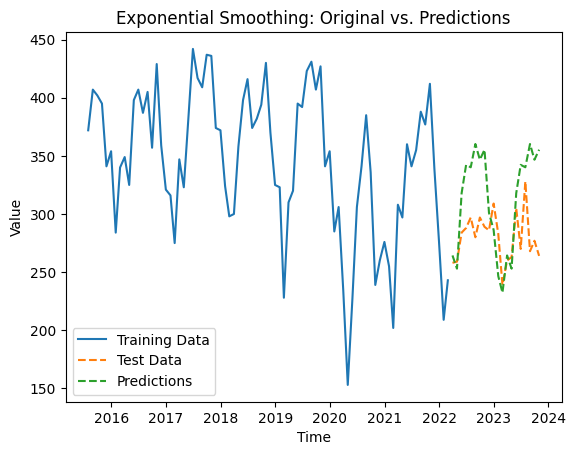

In [18]:
# Plotting the original time series
plt.plot(train, label='Training Data')
plt.plot(test, label='Test Data', linestyle='--')

# Plotting the predictions
plt.plot(predictions_ets, label='Predictions', linestyle='--')

# Adding labels and title
plt.xlabel('Time')
plt.ylabel('Value')
plt.title('Exponential Smoothing: Original vs. Predictions')

# Displaying the legend
plt.legend()

# Show the plot
plt.show()

In [19]:
from sklearn.metrics import mean_squared_error

mse = mean_squared_error(test, predictions_ets)
rmse = np.sqrt(mse)

print(f"Mean Squared error: {mse}")
print(f"Root mean squared error: {rmse}")

Mean Squared error: 2440.3421722818885
Root mean squared error: 49.39981955717944


Predicting the future

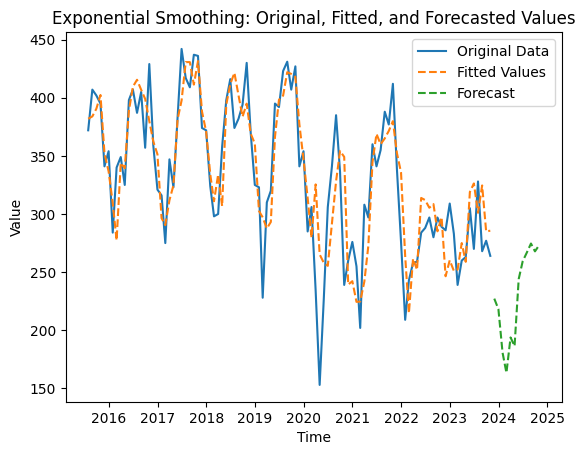

In [20]:
# Set the training size
train_size = int(len(monthly_accident_count) )
train = monthly_accident_count[:train_size]

# Exponential smoothing state space model
ets_model = ExponentialSmoothing(train, seasonal='add', seasonal_periods=12)
fitted_ets_model = ets_model.fit()

# Forecast into the future
forecast_steps = 12  # Set the number of steps to forecast into the future
forecast = fitted_ets_model.forecast(steps=forecast_steps)

# Plotting the original time series
plt.plot(monthly_accident_count, label='Original Data')

# Plotting the fitted values
plt.plot(fitted_ets_model.fittedvalues, label='Fitted Values', linestyle='--')

# Plotting the forecasted values
plt.plot(
    pd.date_range(start=monthly_accident_count.index[-1], periods=forecast_steps + 1, freq='M')[1:],
    forecast,
    label='Forecast',
    linestyle='--'
)

# Adding labels and title
plt.xlabel('Time')
plt.ylabel('Value')
plt.title('Exponential Smoothing: Original, Fitted, and Forecasted Values')

# Displaying the legend
plt.legend()

# Show the plot
plt.show()


---

### Seasonal Decomposition

In [21]:
#Seasonal decomposition of time series data
from statsmodels.tsa.seasonal import STL

stl_model = STL(train, seasonal=13)
stl_result = stl_model.fit()
seasonal, trend, resid = stl_result.seasonal, stl_result.trend, stl_result.resid


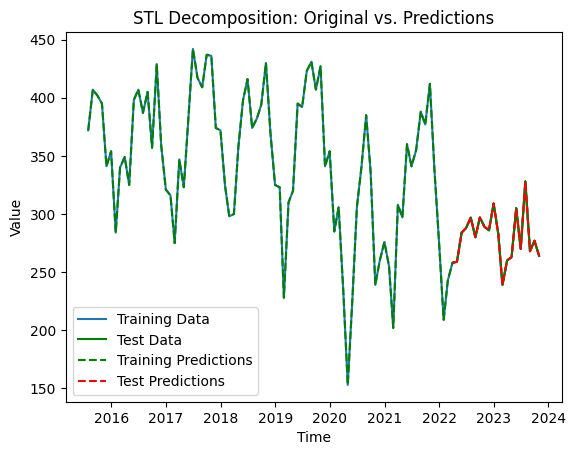

In [22]:
# Combine the components for training data
train_pred = seasonal + trend + resid

# Forecasting using the seasonal, trend, and residual components for the test set
test_pred = seasonal[-len(test):] + trend[-len(test):] + resid[-len(test):]

# Plotting the original time series
plt.plot(train, label='Training Data')
plt.plot(test, label='Test Data', linestyle='-', color='green')

# Plotting the predictions
plt.plot(train_pred, label='Training Predictions', linestyle='--', color='green')
plt.plot(test.index, test_pred, label='Test Predictions', linestyle='--', color = 'red')

# Adding labels and title
plt.xlabel('Time')
plt.ylabel('Value')
plt.title('STL Decomposition: Original vs. Predictions')

# Displaying the legend
plt.legend()

# Show the plot
plt.show()

C:\Users\devch\AppData\Local\Temp\ipykernel_17288\2786900257.py:18: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  forecast_seasonal = stl_result.seasonal[-1] + np.arange(1, forecast_steps + 1)
C:\Users\devch\AppData\Local\Temp\ipykernel_17288\2786900257.py:21: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  forecast_trend = stl_result.trend[-1] + np.arange(1, forecast_steps + 1)
C:\Users\devch\AppData\Local\Temp\ipykernel_17288\2786900257.py:24: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavi

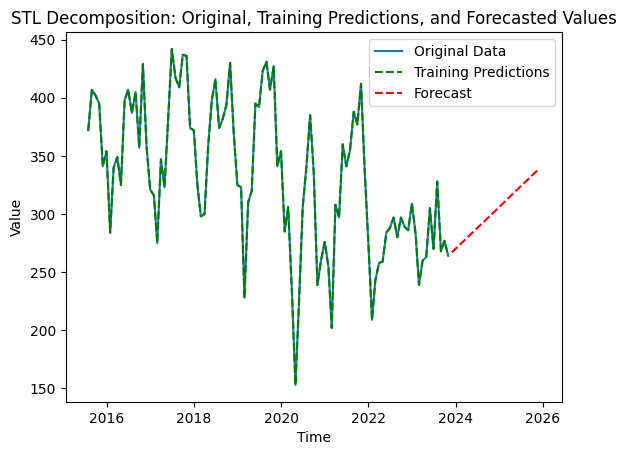

In [26]:

# Set the training size
train_size = int(len(monthly_accident_count))
train = monthly_accident_count[:train_size]
test = monthly_accident_count[train_size:]

# Seasonal decomposition of time series data
stl_model = STL(train, seasonal=13)
stl_result = stl_model.fit()
seasonal, trend, resid = stl_result.seasonal, stl_result.trend, stl_result.resid

# Combine the components for training data
train_pred = seasonal + trend + resid

# Forecasting into the future
forecast_steps = 25  # Set the number of steps to forecast into the future

# Manually predict the future seasonal component
forecast_seasonal = stl_result.seasonal[-1] + np.arange(1, forecast_steps + 1)

# Manually predict the future trend component
forecast_trend = stl_result.trend[-1] + np.arange(1, forecast_steps + 1)

# Manually predict the future residual component
forecast_resid = stl_result.resid[-1] + np.arange(1, forecast_steps + 1)

# Combine the components for forecasting into the future
forecast_pred = forecast_seasonal + forecast_trend + forecast_resid

# Plotting the original time series
plt.plot(monthly_accident_count, label='Original Data')

# Plotting the fitted values
plt.plot(train.index, train_pred, label='Training Predictions', linestyle='--', color='green')

# Plotting the forecasted values
plt.plot(pd.date_range(start=train.index[-1], periods=forecast_steps + 1, freq='M')[1:],
         forecast_pred,
         label='Forecast',
         linestyle='--',
         color='red')

# Adding labels and title
plt.xlabel('Time')
plt.ylabel('Value')
plt.title('STL Decomposition: Original, Training Predictions, and Forecasted Values')

# Displaying the legend
plt.legend()

# Show the plot
plt.show()


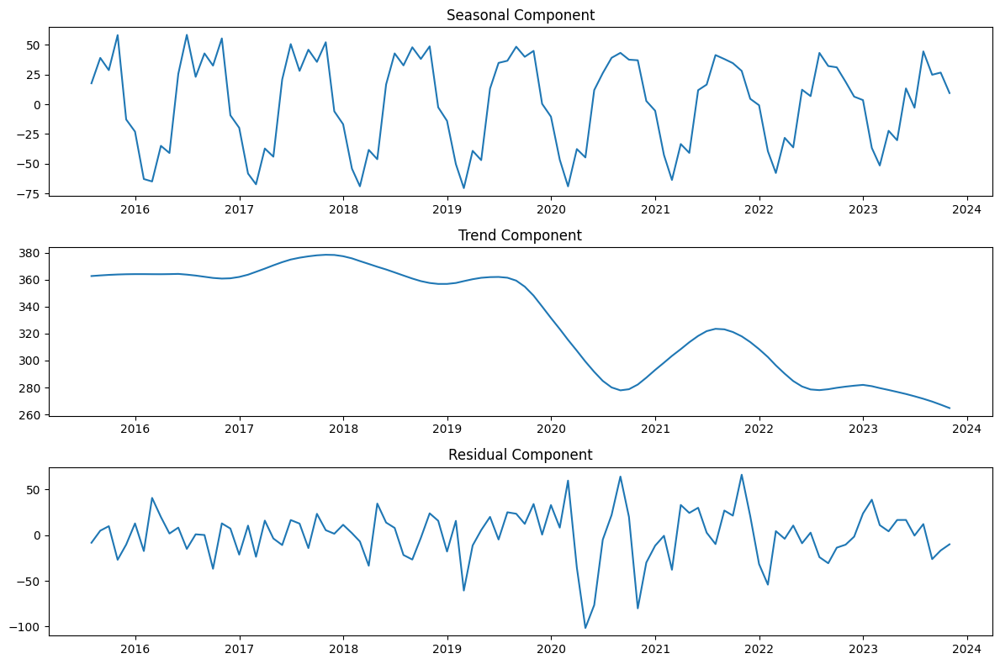

In [27]:
# Seasonal decomposition of time series data
stl_model = STL(train, seasonal=13)
stl_result = stl_model.fit()
seasonal, trend, resid = stl_result.seasonal, stl_result.trend, stl_result.resid

# Plotting the components separately
plt.figure(figsize=(12, 8))

# Plotting the seasonal component
plt.subplot(3, 1, 1)
plt.plot(seasonal)
plt.title('Seasonal Component')

# Plotting the trend component
plt.subplot(3, 1, 2)
plt.plot(trend)
plt.title('Trend Component')

# Plotting the residual component
plt.subplot(3, 1, 3)
plt.plot(resid)
plt.title('Residual Component')

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()

---

## SARIMAX

c:\Users\devch\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\tsa\statespace\sarimax.py:866: UserWarning: Too few observations to estimate starting parameters for seasonal ARMA. All parameters except for variances will be set to zeros.
  warn('Too few observations to estimate starting parameters%s.'


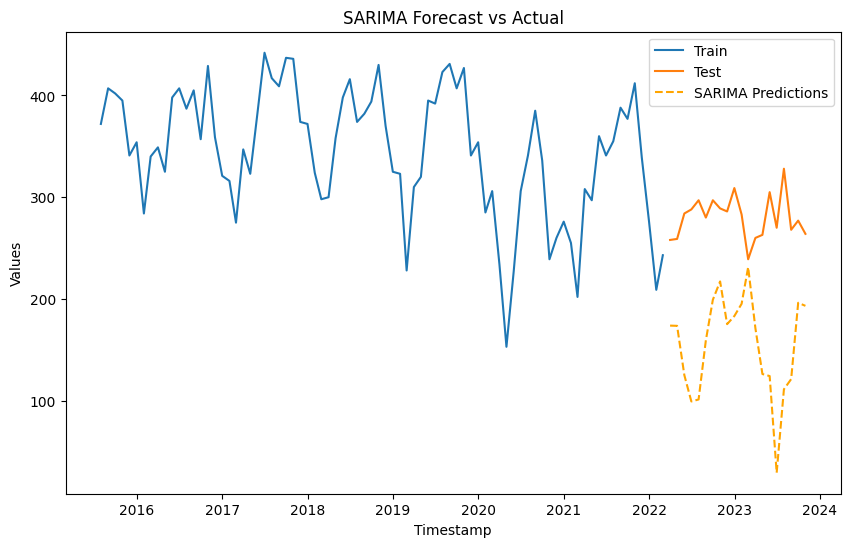

In [31]:
from statsmodels.tsa.statespace.sarimax import SARIMAX

# Split the time series into training and test sets
train_size = int(len(monthly_accident_count) *0.8)
train, test = monthly_accident_count[:train_size], monthly_accident_count[train_size:]

# Define and fit the SARIMA model
order = (1, 1, 1)  # Replace with your chosen order (p, d, q)
seasonal_order = (1, 1, 1, 52)  # Replace with your chosen seasonal order (P, D, Q, m)
model = SARIMAX(train, order=order, seasonal_order=seasonal_order, enforce_stationarity=False, enforce_invertibility=False)
result = model.fit()

# Make predictions on the test set
predictions = result.get_forecast(steps=len(test))
predicted_mean = predictions.predicted_mean

# Plot the results
plt.figure(figsize=(10, 6))
plt.plot(train.index, train, label='Train')
plt.plot(test.index, test, label='Test')
plt.plot(test.index, predicted_mean, label='SARIMA Predictions', linestyle='--', color='orange')
plt.title('SARIMA Forecast vs Actual')
plt.xlabel('Timestamp')
plt.ylabel('Values')
plt.legend()
plt.show()